In [37]:
import sweetviz as sv
import dtale
import pandas as pd, numpy as np
import os
import glob
import sys
import re
from datetime import datetime
from dateutil.parser import parse
from dateutil.relativedelta import relativedelta
import nltk

In [7]:
#load all csv files in folder including subfolders with individual variable names for each file
all_files = glob.glob(os.path.join('./Data/', "**/*.csv"), recursive=True)
all_files

['./Data/aqueduct_v1_20220407_0013.csv',
 './Data/citiesxy.csv',
 './Data/Cities/Cities Disclosing/2018_Cities_Disclosing_to_CDP.csv',
 './Data/Cities/Cities Disclosing/2019_Cities_Disclosing_to_CDP.csv',
 './Data/Cities/Cities Disclosing/2020_Cities_Disclosing_to_CDP.csv',
 './Data/Cities/Cities Disclosing/Cities_Disclosing_to_CDP_Data_Dictionary.csv',
 './Data/Cities/Cities Responses/2018_Full_Cities_Dataset.csv',
 './Data/Cities/Cities Responses/2019_Full_Cities_Dataset.csv',
 './Data/Cities/Cities Responses/2020_Full_Cities_Dataset.csv',
 './Data/Cities/Cities Responses/Full_Cities_Response_Data_Dictionary.csv',
 './Data/Corporations/Corporations Disclosing/Climate Change/2018_Corporates_Disclosing_to_CDP_Climate_Change.csv',
 './Data/Corporations/Corporations Disclosing/Climate Change/2019_Corporates_Disclosing_to_CDP_Climate_Change.csv',
 './Data/Corporations/Corporations Disclosing/Climate Change/2020_Corporates_Disclosing_to_CDP_Climate_Change.csv',
 './Data/Corporations/Corpor

In [8]:
# using the given city administative organizations in the disclosure data we create a mapping between 
# account numbers and city names for some of the cities which do not have a value in the 'City' column
# this will be used to match OECD economic data with the CDP cities 
ACCOUNT_MAPPING = {
    74643: 'Dijon',
    50377: 'Queretaro',
    74607: 'Alkmaar',
    833284: 'West Midlands urban area',
    50540: 'Albuquerque',
    74575: 'Dane',
    74534: 'Erie (NY)',
    74563: 'Guilford',
    74546: 'Milwaukee',
    832610: 'Orange',
    59531: 'Santa Barbara',
    74558: 'Summit',
    834373: 'York'
}

# used in city_gdp
COUNTRY_CODES = {
    'AT': 'Austria',
    'AUS': 'Australia',
    'BE': 'Belgium',
    'CAN': 'Canada',
    'CH': 'Switzerland',
    'CL': 'Chile',
    'CZ': 'Czech Republic',
    'DE': 'Germany',
    'DK': 'Denmark',
    'EE': 'Estonia',
    'EL': 'Greece',
    'ES': 'Spain',
    'FI': 'Finland',
    'FR': 'France',
    'HU': 'Hungary',
    'IE': 'Ireland',
    'IT': 'Italy',
    'JPN': 'Japan',
    'KOR': 'Republic of Korea',
    'LT': 'Lithuania',
    'LU': 'Luxembourg',
    'LV': 'Latvia',
    'MEX': 'Mexico',
    'NL': 'Netherlands',
    'NO': 'Norway',
    'PL': 'Poland',
    'PT': 'Portugal',
    'SE': 'Sweden',
    'SI': 'Slovenia',
    'SK': 'Slovakia',
    'UK': 'United Kingdom of Great Britain and Northern Ireland',
    'USA': 'United States of America'
}

# used in city_gdp
NORM_CITY_NAMES = {
    'Montreal': 'Montréal',
    'Zurich': 'Zürich',
    'Mannheim-Ludwigshafen': 'Mannheim',
    'Malaga': 'Málaga',
    'Vitoria': 'Vitoria-Gasteiz',
    'Florence': 'Firenze',
    'Genoa': 'Genova',
    'Milan': 'Milano',
    'Naples': 'Napoli',
    'Padua': 'Padova',
    'Reggio nell\'Emilia': 'Reggio Emilia',
    'Rome': 'Roma',
    'Turin': 'Torino',
    'Venice': 'Venezia',
    'Merida': 'Mérida',
    'Gdansk': 'Gdańsk',
    'Gothenburg': 'Göteborg',
    'Greater Adelaide': 'Adelaide',
    'Greater Melbourne': 'City of Melbourne',
    'Greater Perth': 'Perth',
    'Greater Sydney': 'City of Sydney',
    'Malmo': 'Malmö',
    'West Midlands urban area': 'Birmingham',
    'Detroit (Greater)': 'Detroit',
    'Durham': 'Durham, NC',
    'Fresno (Greater)': 'Fresno',
    'Lancaster (PA)': 'Lancaster, PA',
    'Los Angeles (Greater)': 'Los Angeles',
    'Miami (Greater)': 'Miami',
    'New York (Greater)': 'New York City',
    'Philadelphia (Greater)': 'Philadelphia',
    'Portland': 'Portland, OR',
    'Richmond (Greater)': 'Richmond, VA',
    'Rochester (NY)': 'Rochester',
    'Salt Lake': 'Salt Lake City',
    'San Francisco (Greater)': 'San Francisco',
    'Santa Cruz': 'Santa Cruz, CA',
    'St. Louis': 'St Louis',
    'Washington (Greater)': 'Washington, DC'
}

# used in energy_use
COUNTRY_NAMES = {
    'Bolivia': 'Bolivia (Plurinational State of)',
    'Democratic Republic of Congo': 'Democratic Republic of the Congo',
    'Hong Kong': 'China, Hong Kong Special Administrative Region',
    'Moldova': 'Republic of Moldova',
    'Palestine': 'State of Palestine',
    'Russia': 'Russian Federation',
    'South Korea': 'Republic of Korea',
    'Taiwan': 'Taiwan, Greater China',
    'United Kingdom': 'United Kingdom of Great Britain and Northern Ireland',
    'United States': 'United States of America',
    'Venezuela': 'Venezuela (Bolivarian Republic of)',
    'Vietnam': 'Viet Nam'
}

# used in corp_locations
STATE_CODES = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'Ca': 'CA',
    'California': 'CA',
    'Colorado': 'CO',
    'COLORADO': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY',
    'ALBERTA': 'AB',
    'Quebec': 'QC',
    'Manitoba': 'MB',
    'Ontario': 'ON'
}

In [9]:
# LOAD CITY DATA
PATH = './Data/Cities/'

# disclosing data
cd2020 = pd.read_csv(PATH + "Cities Disclosing/2020_Cities_Disclosing_to_CDP.csv")
cd2019 = pd.read_csv(PATH + "Cities Disclosing/2019_Cities_Disclosing_to_CDP.csv")
cd2018 = pd.read_csv(PATH + "Cities Disclosing/2018_Cities_Disclosing_to_CDP.csv")
cities_dis = pd.concat([cd2020, cd2019, cd2018])

# getting city name from ACCOUNT MAPPING
cities_dis['City'] = cities_dis['City'].fillna(cities_dis['Account Number'].map(ACCOUNT_MAPPING))

# response data
cr2020 = pd.read_csv(PATH + "Cities Responses/2020_Full_Cities_Dataset.csv")
cr2019 = pd.read_csv(PATH + "Cities Responses/2019_Full_Cities_Dataset.csv")
cr2018 = pd.read_csv(PATH + "Cities Responses/2018_Full_Cities_Dataset.csv")
cities_res = pd.concat([cr2020, cr2019, cr2018])

# merging disclosing data with response data
cities = pd.merge(cities_dis, cities_res, 'inner', on=['Year Reported to CDP', 'Account Number', 'Organization', 'Country', 'CDP Region',])
# the following columns contain data we do not need, and are dropped
cities.drop(columns=['Access', 'File Name', 'Last update_x', 'Last update_y'], inplace=True)


# creating population dataframe using the most recent values present in the disclosure data
population = cities_dis[['City', 'Account Number', 'Year Reported to CDP', 'Population']].dropna(subset=['Population']).reset_index(drop=True)
population = population.loc[population.groupby(['City', 'Account Number'])['Year Reported to CDP'].idxmax()].set_index(['City', 'Account Number'])['Population']


# creating a city location dataframe to facilitate geo-plotting 
city_locations = cities_dis[['Country', 'City', 'Account Number', 'City Location']].drop_duplicates().dropna(subset=['City Location']).set_index('City')
city_locations[['lon', 'lat']] = city_locations['City Location'].apply(lambda x: pd.Series(x.split("POINT ")[1].strip('()').split())).astype('float32')

#fixing inverted coordinates
for org in ['Mississauga', 'Norfolk', 'Aurora', 'South Bend', 'San José']:
    city_locations.at[org, 'lat'], city_locations.at[org, 'lon'] = city_locations.loc[org]['lon'], city_locations.loc[org]['lat']
# Aurora also has the negative sgin missing
city_locations.at['Aurora', 'lon'] = -city_locations.loc['Aurora']['lon']
city_locations = city_locations.set_index('Country', append=True)


# deleting temperory variables
del cities_res, cd2018, cd2019, cr2018, cr2019, cr2020
# ------------------------------------------------------

# LOAD CLIMATE DATA
PATH2 = './Data/Corporations/'

# disclosing
cd_cc2018 = pd.read_csv(PATH2 + 'Corporations Disclosing/Climate Change/2018_Corporates_Disclosing_to_CDP_Climate_Change.csv')
cd_cc2019 = pd.read_csv(PATH2 + 'Corporations Disclosing/Climate Change/2019_Corporates_Disclosing_to_CDP_Climate_Change.csv')
cd_cc2020 = pd.read_csv(PATH2 + 'Corporations Disclosing/Climate Change/2020_Corporates_Disclosing_to_CDP_Climate_Change.csv')
cc_dis = pd.concat([cd_cc2020, cd_cc2019, cd_cc2018])

# responses
cr_cc2018 = pd.read_csv(PATH2 + 'Corporations Responses/Climate Change/2018_Full_Climate_Change_Dataset.csv')
cr_cc2019 = pd.read_csv(PATH2 + 'Corporations Responses/Climate Change/2019_Full_Climate_Change_Dataset.csv')
cr_cc2020 = pd.read_csv(PATH2 + 'Corporations Responses/Climate Change/2020_Full_Climate_Change_Dataset.csv')
cc_res = pd.concat([cr_cc2020, cr_cc2019, cr_cc2018])

# merge disclosing data with responses
climate = pd.merge(cc_dis, cc_res, 'inner', on=['survey_year', 'account_number', 'organization', 'response_received_date'])
climate['comments'] = climate['comments'].astype(str)

# delete temporary variables
del cc_res, cd_cc2018, cd_cc2019, cd_cc2020, cr_cc2018, cr_cc2019, cr_cc2020
# ------------------------------------------------------

# LOAD WATER SECURITY DATA
PATH2 = './Data/Corporations/'

# disclosing
cd_ws2018 = pd.read_csv(PATH2 + 'Corporations Disclosing/Water Security/2018_Corporates_Disclosing_to_CDP_Water_Security.csv')
cd_ws2019 = pd.read_csv(PATH2 + 'Corporations Disclosing/Water Security/2019_Corporates_Disclosing_to_CDP_Water_Security.csv')
cd_ws2020 = pd.read_csv(PATH2 + 'Corporations Disclosing/Water Security/2020_Corporates_Disclosing_to_CDP_Water_Security.csv')
ws_dis = pd.concat([cd_ws2020, cd_ws2019, cd_ws2018])

# responses
cr_ws2018 = pd.read_csv(PATH2 + 'Corporations Responses/Water Security/2018_Full_Water_Security_Dataset.csv')
cr_ws2019 = pd.read_csv(PATH2 + 'Corporations Responses/Water Security/2019_Full_Water_Security_Dataset.csv')
cr_ws2020 = pd.read_csv(PATH2 + 'Corporations Responses/Water Security/2020_Full_Water_Security_Dataset.csv')
ws_res = pd.concat([cr_ws2020, cr_ws2019, cr_ws2018])

# merge disclosing and response data
water = pd.merge(ws_dis, ws_res, 'inner', on=['survey_year', 'account_number', 'organization', 'response_received_date'])

# delete temporary variables
del ws_res, cd_ws2018, cd_ws2019, cd_ws2020, cr_ws2018, cr_ws2019, cr_ws2020

/var/folders/bb/ltbm_p0s1hxctmnwcw7y5yxw0000gn/T/ipykernel_40701/2579393213.py:57: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  cr_cc2019 = pd.read_csv(PATH2 + 'Corporations Responses/Climate Change/2019_Full_Climate_Change_Dataset.csv')
/var/folders/bb/ltbm_p0s1hxctmnwcw7y5yxw0000gn/T/ipykernel_40701/2579393213.py:58: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  cr_cc2020 = pd.read_csv(PATH2 + 'Corporations Responses/Climate Change/2020_Full_Climate_Change_Dataset.csv')
/var/folders/bb/ltbm_p0s1hxctmnwcw7y5yxw0000gn/T/ipykernel_40701/2579393213.py:80: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  cr_ws2019 = pd.read_csv(PATH2 + 'Corporations Responses/Water Security/2019_Full_Water_Security_Dataset.csv')
/var/folders/bb/ltbm_p0s1hxctmnwcw7y5yxw0000gn/T/ipykernel_40701/2579393213.py:81: DtypeWarning: Columns (19) ha

Done! Use 'show' commands to display/save.   |██████████| [100%]   00:00 -> (00:00 left)



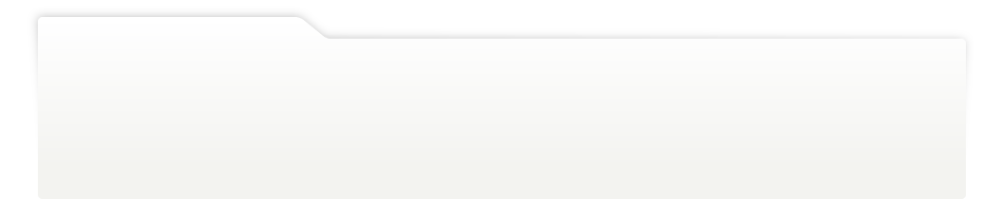
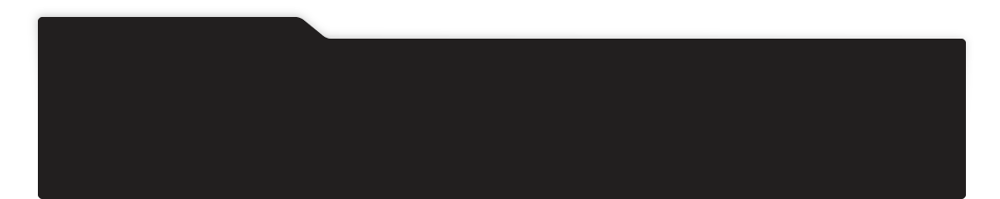
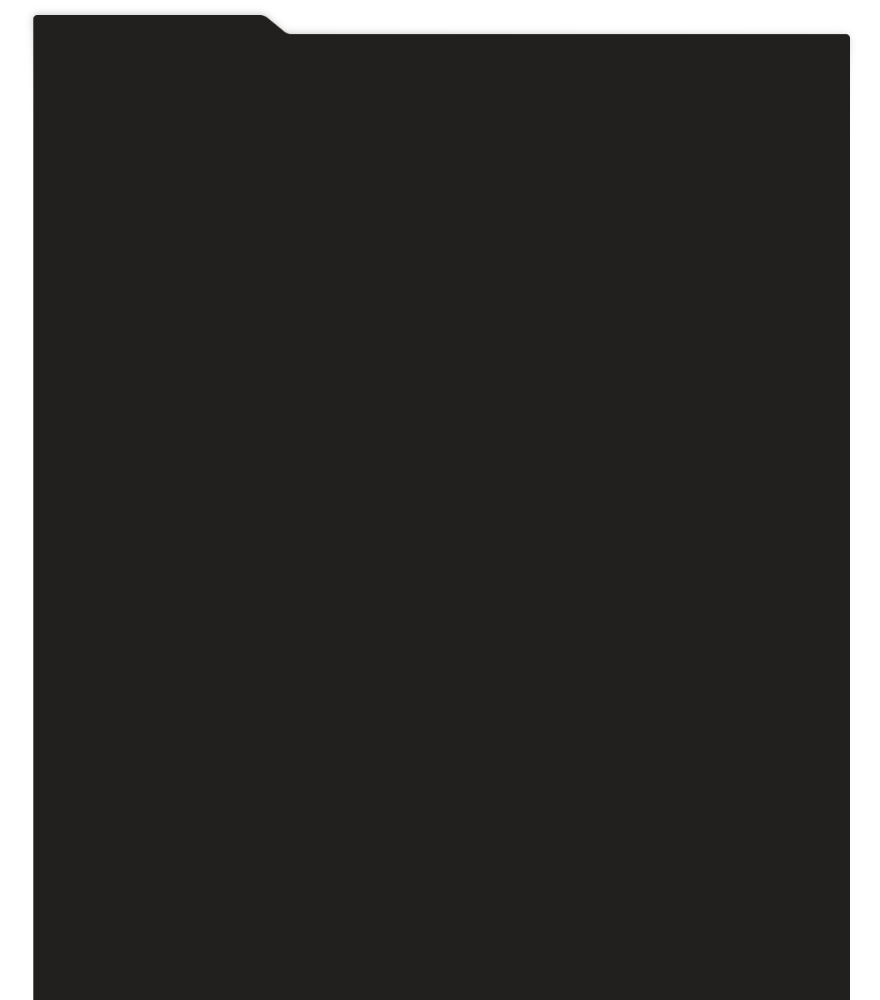
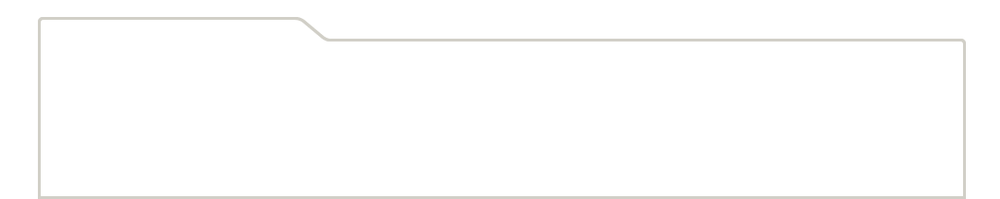
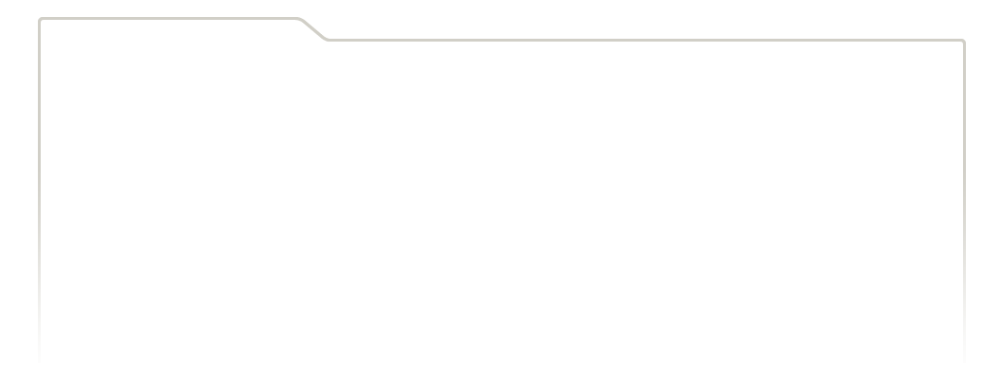
...
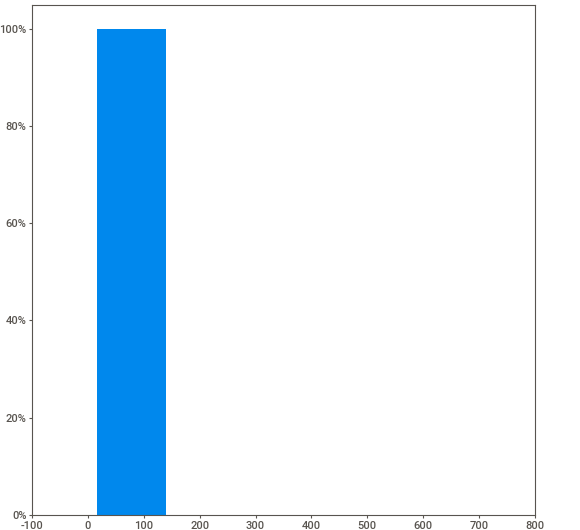
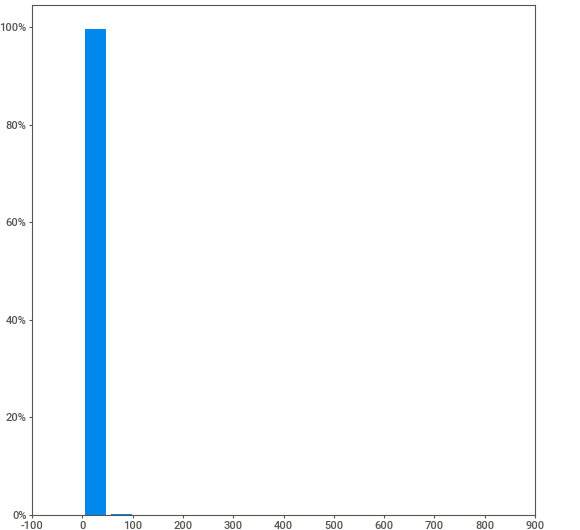
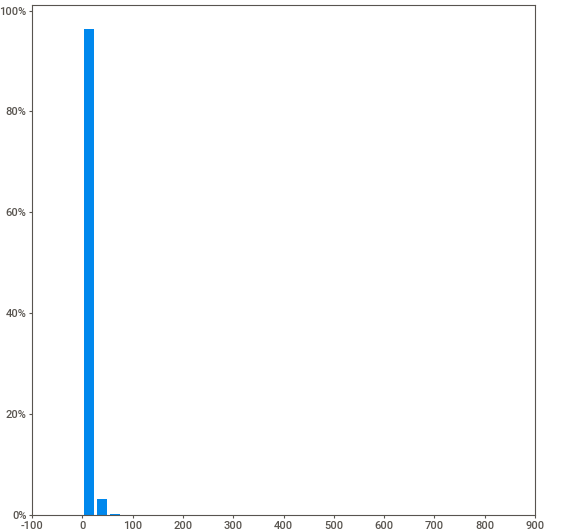
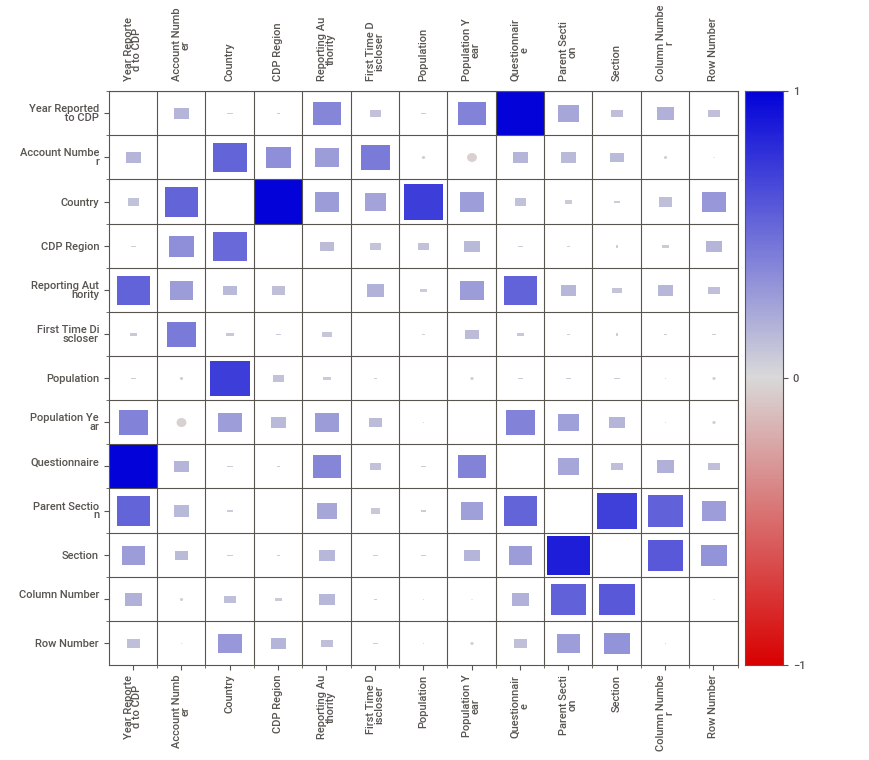
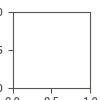

In [6]:
sv.analyze([cities,'cities']).show_notebook()

In [10]:
citiesxy=pd.DataFrame(cities[(cities['Parent Section']=='Water') | (cities['Parent Section']=='Water Security')])
citiesxy.dropna(subset=['Comments', 'City Location'], inplace=True)

In [11]:
citiesxy.Comments

14758      The water management is delegated to the munic...
14762      The water management is delegated to the munic...
14835      The water management is delegated to the munic...
14910      The water management is delegated to the munic...
15471      The water management is delegated to the munic...
                                 ...                        
1527009    No se cuenta con la información sobre porcenta...
1527039    No se cuenta con la información sobre porcenta...
1527051    No se cuenta con la información sobre porcenta...
1527476    2017 data.The mainland is almost 100% served w...
1534285    Las fuente de suministro de agua que abastece ...
Name: Comments, Length: 849, dtype: object

In [12]:
# import VADER sentiment analysis
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# instantiate SentimentIntensityAnalyzer
analyzer = SentimentIntensityAnalyzer()

# create empty list to store sentiment scores
sentiment_scores = []

# loop through each row in 'cities' dataframe
for row in citiesxy['Comments']:
    # run sentiment analysis on each row
    sentiment = analyzer.polarity_scores(row)
    # append sentiment score to 'sentiment_scores' list
    sentiment_scores.append(sentiment['compound'])

# add 'sentiment_scores' list to 'cities' dataframe
citiesxy['Sentiment'] = sentiment_scores
citiesxy['Category'] = 'Cities'

# add 'latitude (decimal degrees)' and 'longitude (decimal degrees)' fields to 'citiesxy' dataframe according to 'City Location'

# Create a new column 'latitude (decimal degrees)' with the right values according to the 'City Location' column.
citiesxy['latitude (decimal degrees)'] = citiesxy['City Location'].str.extract(r'\((.*?)\)')[0].str.split().str[1]

# Create a new column 'longitude (decimal degrees)' with the right values according to the 'City Location' column.
citiesxy['longitude (decimal degrees)'] = citiesxy['City Location'].str.extract(r'\((.*?)\)')[0].str.split().str[0]

# Convert the 'latitude (decimal degrees)' and 'longitude (decimal degrees)' columns to float type.
citiesxy['latitude (decimal degrees)'] = citiesxy['latitude (decimal degrees)'].astype(float)
citiesxy['longitude (decimal degrees)'] = citiesxy['longitude (decimal degrees)'].astype(float)

Feature: Organization                        |█         | [ 11%]   00:00 -> (00:01 left)C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\utils.py:34: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  clamped_series = clamped_series.append(other_series, ignore_index=False)
C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\utils.py:34: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  clamped_series = clamped_series.append(other_series, ignore_index=False)
C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\utils.py:34: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  clamped_series = clamped_series.append(other_series, ignore_index=False)
Feature: City                                |█▍        |


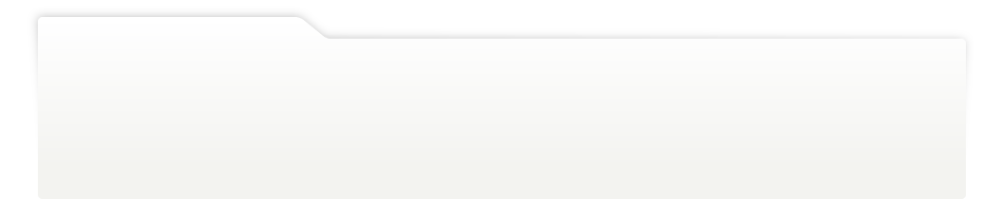
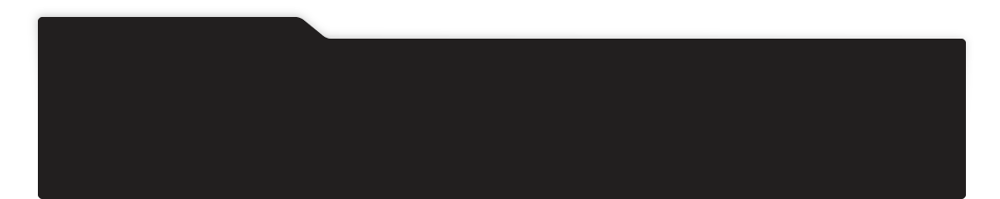
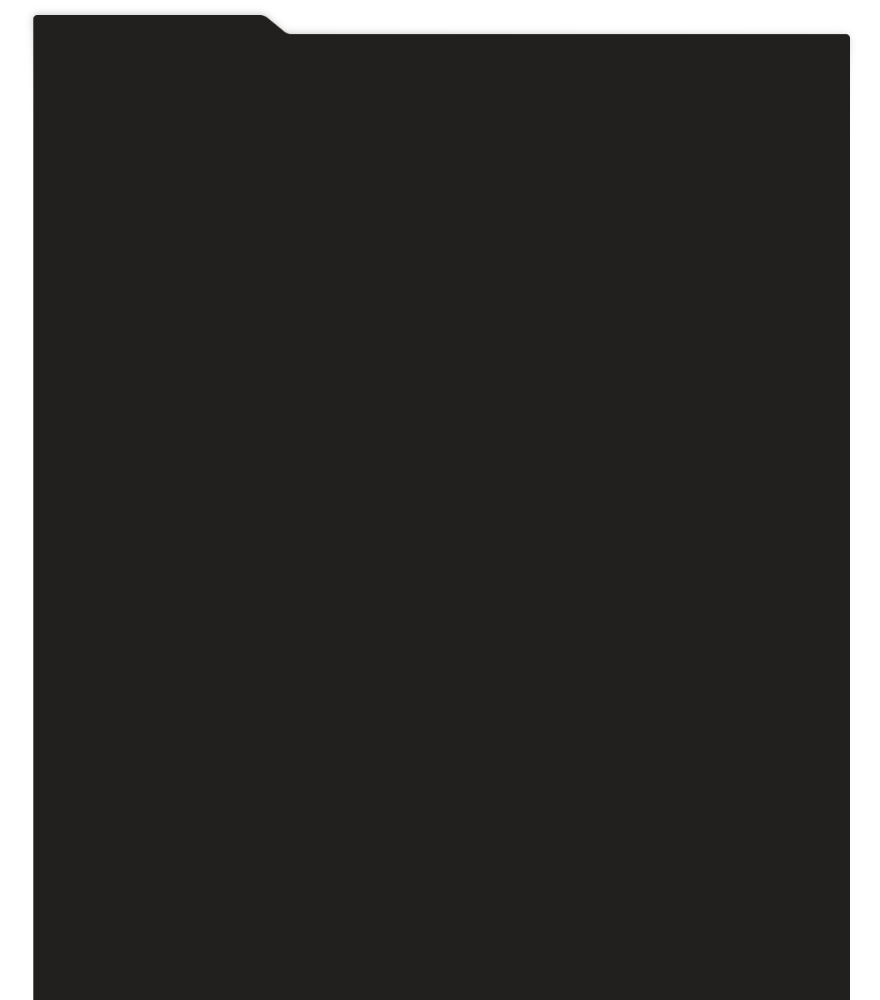
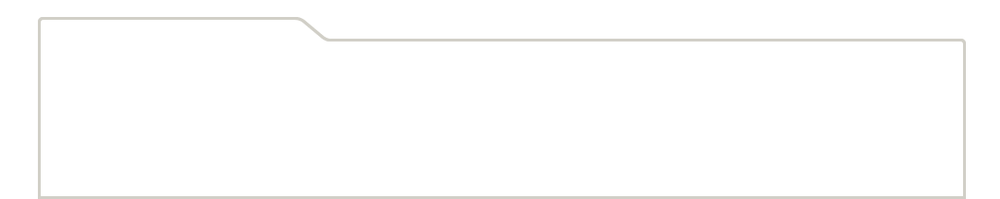
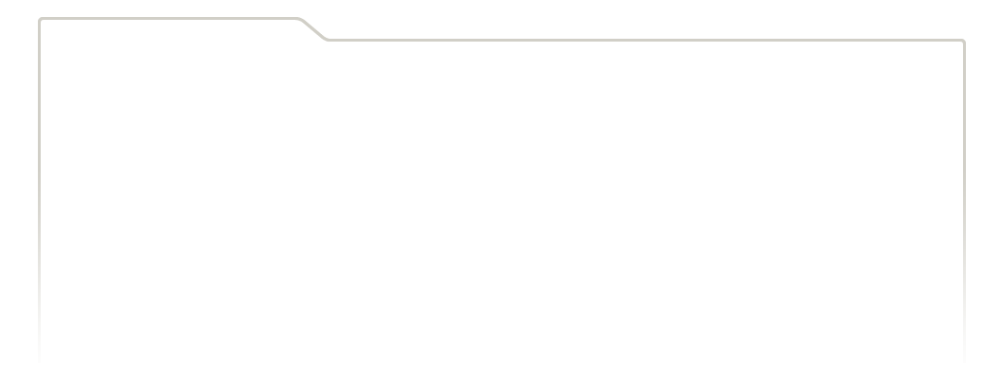
...
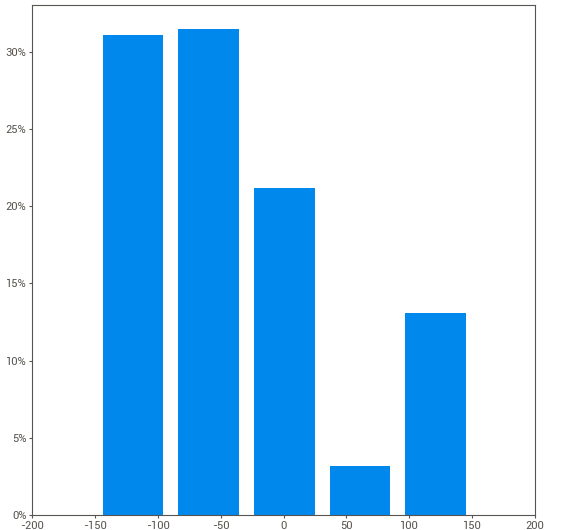
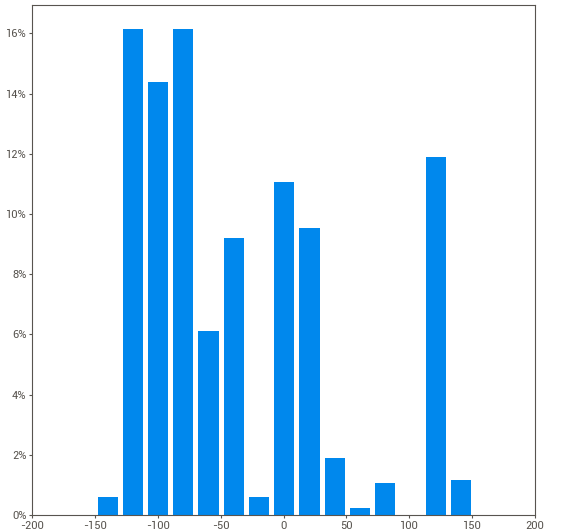
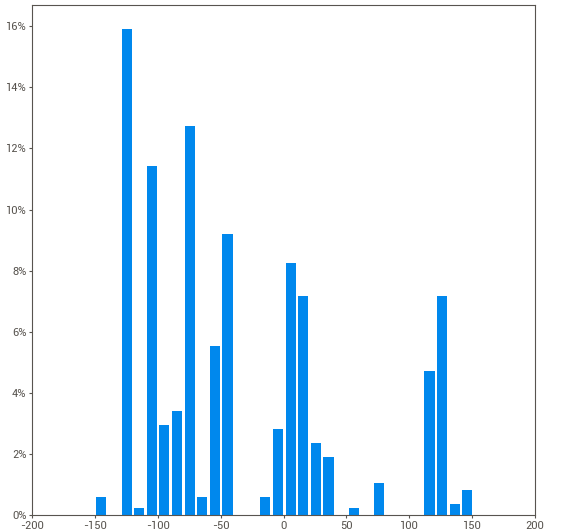
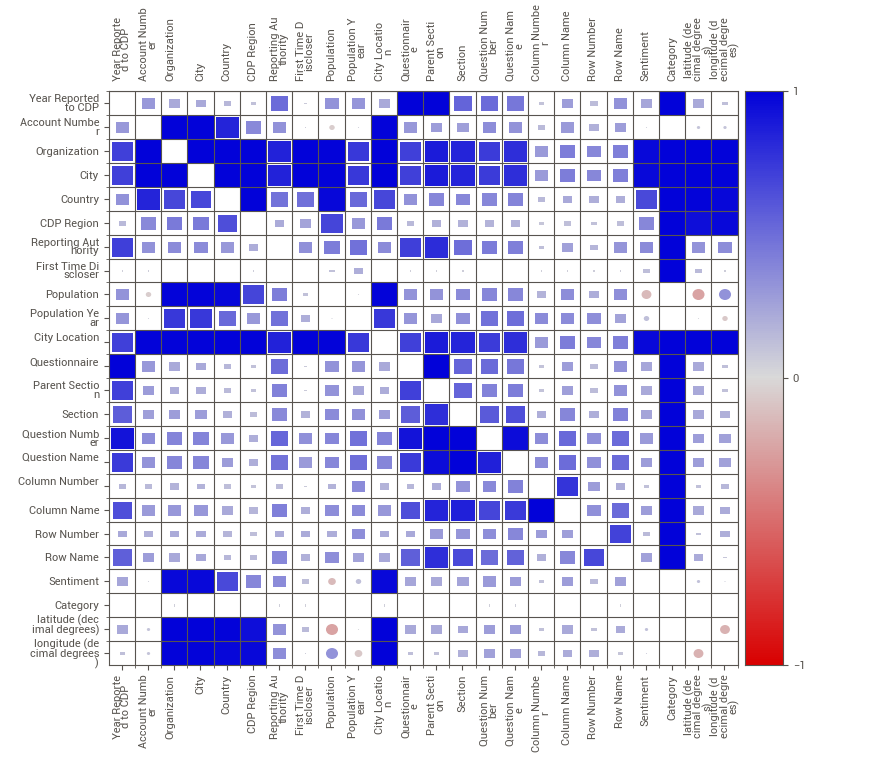
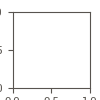

In [30]:
sv.analyze([citiesxy,'citiesxy']).show_notebook(h=1000)

In [14]:
citiesxy[citiesxy['Year Reported to CDP']==2019].drop_duplicates(subset=['Account Number']).to_csv('./Data/citiesxy.csv', columns=['Account Number', 'Organization', 'latitude (decimal degrees)', 'longitude (decimal degrees)'], index=False)

In [15]:
citiesavg = citiesxy[citiesxy['Year Reported to CDP']==2019].groupby(['Account Number', 'Organization']).mean().reset_index()

In [16]:
aqueducttool = pd.read_csv('./Data/aqueduct_v1_20220407_0013.csv', low_memory=False)
#rename multiple columns in aqueducttool
aqueducttool.rename(columns={'points_id': 'Account Number', 'location_name': 'Organization'}, inplace=True)
citiescombined = pd.merge(citiesavg,aqueducttool,on=['Account Number', 'Organization'])
citiescombined.Sentiment = citiescombined.Sentiment*-1
citiescombined
#feature scale proportionally the Sentiment column in 'citiescombined' Dataframe to between 0 and 5. After feature scaling, the minimum value has to be 0 and the maximum value has to be 5.
citiescombined['Sentiment'] = (citiescombined['Sentiment'] - citiescombined['Sentiment'].min()) / (citiescombined['Sentiment'].max() - citiescombined['Sentiment'].min()) * 5

Feature: Population Year                     |▏         | [  2%]   00:00 -> (00:34 left)C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\utils.py:34: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  clamped_series = clamped_series.append(other_series, ignore_index=False)
Feature: Row Number                          |▎         | [  2%]   00:01 -> (00:50 left)C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\utils.py:34: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  clamped_series = clamped_series.append(other_series, ignore_index=False)
[Step 3/3] Generating associations graph     |          | [  0%]   00:00 -> (? left)    C:\Users\zytoh\.conda\envs\sweetviz\lib\site-packages\sweetviz\graph_associations.py:219: PerformanceWarning: DataFrame is highly fragmented.  This is usually the res


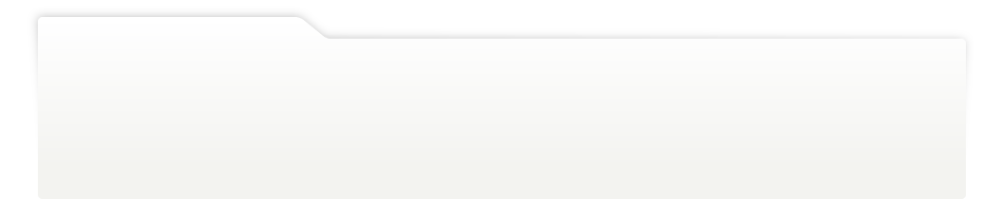
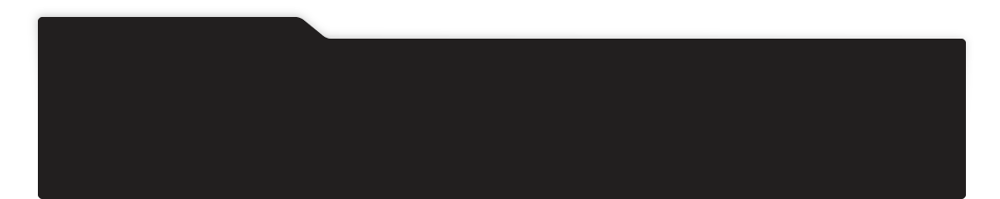
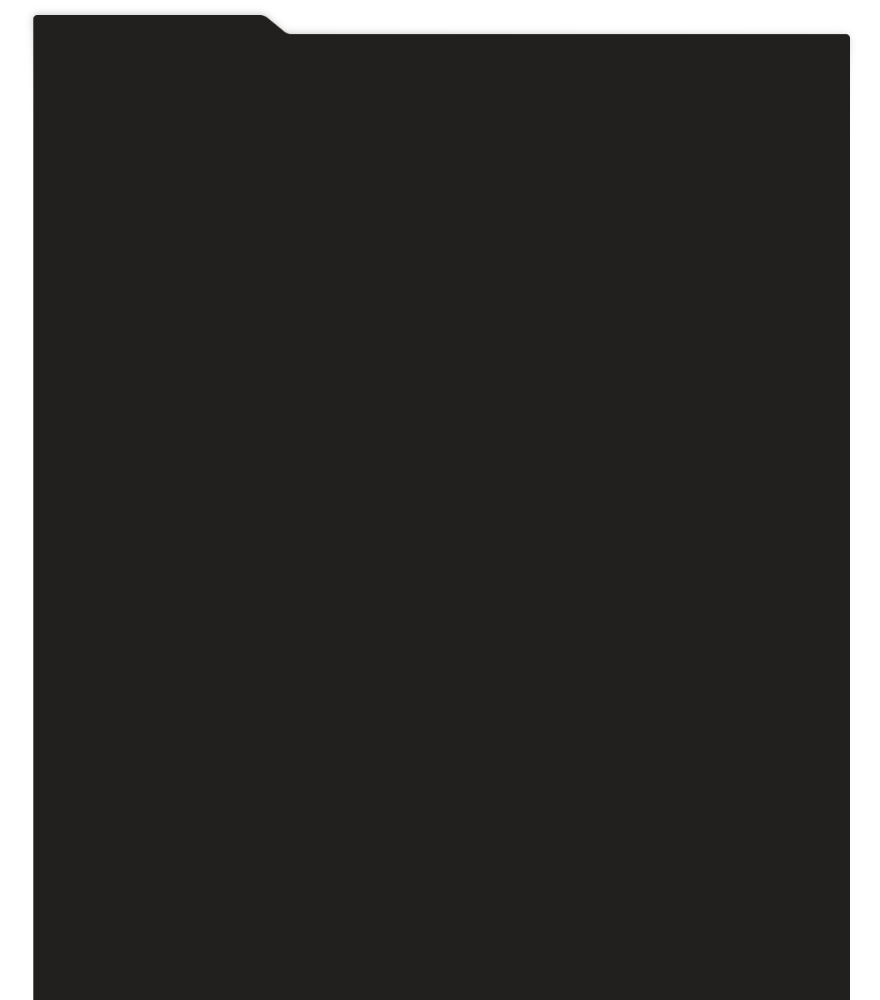
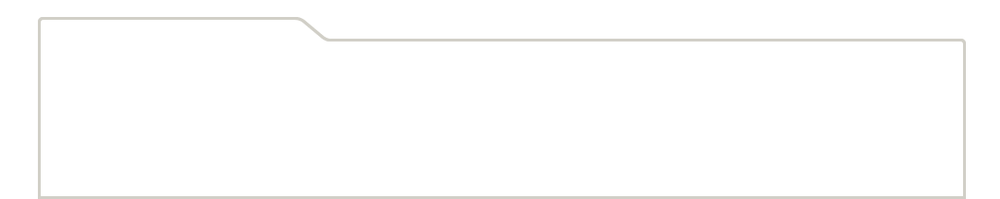
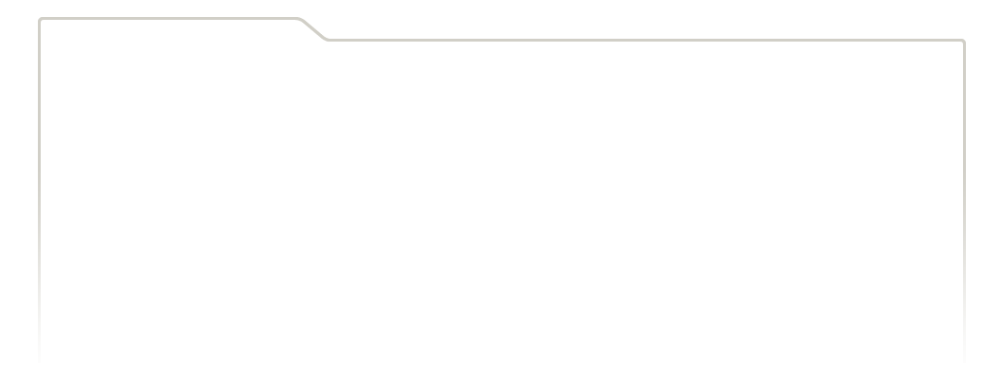
...
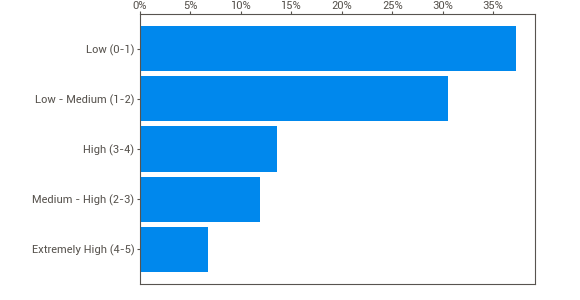
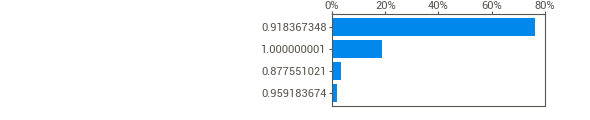
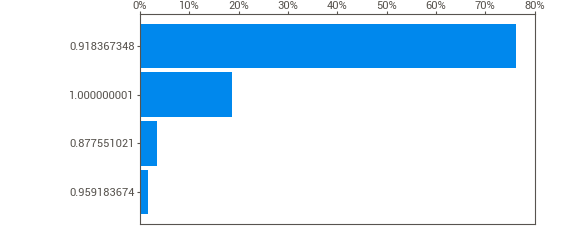
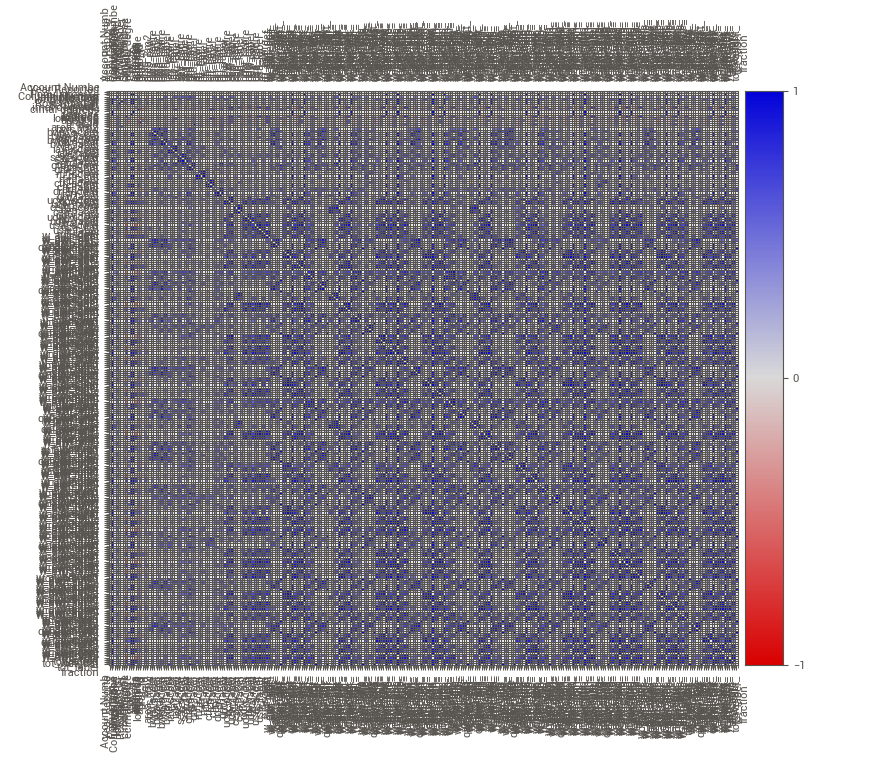
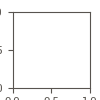

In [163]:
sv.analyze([citiescombined,'citiescombined'], pairwise_analysis='on').show_notebook(h=1000)

In [17]:
# Import necessary libraries
import geopandas as gpd
import matplotlib.pyplot as plt
import folium

# Read in the data
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Create a GeoDataFrame from the citiescombined DataFrame
sentimentplot = gpd.GeoDataFrame(citiescombined, geometry=gpd.points_from_xy(citiescombined.longitude, citiescombined.latitude))
column = 'Sentiment'

m = world.explore(
     scheme="naturalbreaks",  # use mapclassify's natural breaks scheme
     legend=True, # show legend
     k=10, # use 10 bins
     legend_kwds=dict(colorbar=False), # do not use colorbar
     name="countries" # name of the layer in the map
)

sentimentplot.explore(
     column=column,  # use the 'Sentiment' column
     m=m, # pass the map object
     cmap='RdYlGn_r',
     marker_kwds=dict(radius=7.5, fill=True), # make marker radius 10px with fill
     tooltip=["Organization", column], # show "name" column in the tooltip
     tooltip_kwds=dict(labels=True), # do not show column label in the tooltip   
)

folium.TileLayer('Stamen Toner', control=True).add_to(m)  # use folium to add alternative tiles
folium.LayerControl().add_to(m)  # use folium to add layer control

m  # show map

/Users/zhiyuantoh/opt/anaconda3/envs/geoenv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [18]:
# Create a GeoDataFrame from the citiescombined DataFrame
riskplot = gpd.GeoDataFrame(citiescombined, geometry=gpd.points_from_xy(citiescombined.longitude, citiescombined.latitude))
column = 'w_awr_def_tot_score'

m = world.explore(
     scheme="naturalbreaks",  # use mapclassify's natural breaks scheme
     legend=True, # show legend
     k=10, # use 10 bins
     legend_kwds=dict(colorbar=False), # do not use colorbar
     name="countries" # name of the layer in the map
)

riskplot.explore(
     column=column,  # use the 'w_awr_def_tot_score' column
     m=m, # pass the map object
     cmap='RdYlGn_r',
     marker_kwds=dict(radius=7.5, fill=True), # make marker radius 10px with fill
     tooltip=["Organization", column], # show "name" column in the tooltip
     tooltip_kwds=dict(labels=True), # do not show column label in the tooltip
     vmin=0,vmax=5
)

folium.TileLayer('Stamen Toner', control=True).add_to(m)  # use folium to add alternative tiles
folium.LayerControl().add_to(m)  # use folium to add layer control

m  # show map

In [19]:
# Create a column to calculate descripency between the Sentiment and the Default Total, Overall water risk score i.e. Sentiment - Default Total, Overall water risk score
citiescombined['Difference'] = citiescombined['Sentiment'] - citiescombined['w_awr_def_tot_score']

# Create a GeoDataFrame from the citiescombined DataFrame
discrepancyplot = gpd.GeoDataFrame(citiescombined, geometry=gpd.points_from_xy(citiescombined.longitude, citiescombined.latitude))
column = 'Difference'

m = world.explore(
     scheme="naturalbreaks",  # use mapclassify's natural breaks scheme
     legend=True, # show legend
     k=10, # use 10 bins
     legend_kwds=dict(colorbar=False), # do not use colorbar
     name="countries" # name of the layer in the map
)

riskplot.explore(
     column=column,  # use the 'w_awr_def_tot_score' column
     m=m, # pass the map object
     cmap='RdYlGn_r',
     marker_kwds=dict(radius=7.5, fill=True), # make marker radius 10px with fill
     tooltip=["Organization", column], # show "name" column in the tooltip
     tooltip_kwds=dict(labels=True), # do not show column label in the tooltip
     vmin=-5,vmax=5
)

folium.TileLayer('Stamen Toner', control=True).add_to(m)  # use folium to add alternative tiles
folium.LayerControl().add_to(m)  # use folium to add layer control

m  # show map

/var/folders/bb/ltbm_p0s1hxctmnwcw7y5yxw0000gn/T/ipykernel_40701/198622320.py:8: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



<AxesSubplot:>

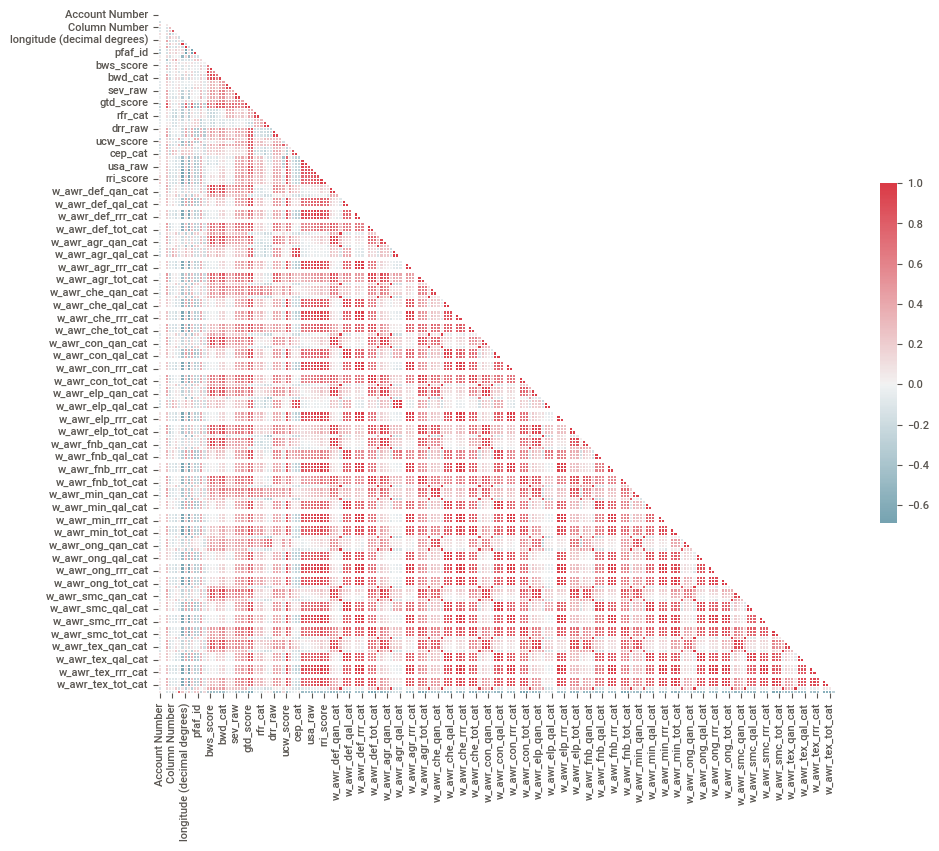

In [32]:
import plotly.graph_objects as go
import plotly.express as px

# Create a correlation matrix
corr = citiescombined.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [38]:
dtale.show(citiescombined)

In [22]:
citiescombined.to_csv('./Data/citiescombined.csv', index=False)
citiescombined.to_excel('./Data/citiescombined.xlsx', index=False)